# DBSCAN CLUSTERING - Filter Features Method - 6 months data
### Group C Workgroup

### Downloads (optional)

In [1]:
# Libraries instalation

#! pip install --user pandas
#! pip install --user numpy
#! pip install --user pandas-profiling
#! pip install --user matplotlib.pyplot
#! pip install --user xgboost
#! pip install --user graphviz
#! pip install --user seaborn
#! pip install --user sklearn
#! pip install --user kneed
#! pip install --user yellowbrick
#! pip install mysql-connector-python
#! pip install chart-studio
#! pip install pandas_profiling

In [2]:
# Packages

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn.utils
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans, DBSCAN
from sklearn import metrics
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
import seaborn as sns
from __future__ import division
from chart_studio import plotly
import plotly.offline as pyoff
import plotly.graph_objs as go

%matplotlib inline

### Dataset reading

In [3]:
# Dataset import

df0 = pd.read_csv('df_users.csv',sep=',')
df0.head()

,CustomerUniqueIdEmailHash,num_orders,country,payment_method,order_carrier,order_shipping_price_mean,order_shipping_price_sum,order_shipping_price_last,product_qty_ordered_mean,product_qty_ordered_sum,...,num_orders_15d,net_amount_15d,num_orders_30d,net_amount_30d,num_orders_60d,net_amount_60d,num_orders_90d,net_amount_90d,will_purchase,next_order_days
0,00029736b495db897a94099c5378a6c0ac76e288,1,GB,paypal,ctbctt,5.26,5.26,5.26,3.0,3.0,...,1.0,39.03,1.0,39.03,1.0,39.03,1.0,39.03,1.0,16.0
1,00031ac41eb5b21be5b4fbc1d50dd43948e01357,1,GB,stripe,ctbdhl,0.00,0.00,0.00,4.0,4.0,...,0.0,0.00,0.0,0.00,0.0,0.00,0.0,0.00,1.0,54.0
2,00035cffce191437bd00adea61d73a346b3965d5,1,DE,m2epropayment,ctbctt,5.85,5.85,5.85,3.0,3.0,...,1.0,19.05,1.0,19.05,1.0,19.05,1.0,19.05,0.0,9999.0
3,0003dfdcbabb0a33168e9b5b09b1f08fb0a960f9,1,NZ,stripe,ctbctt,4.46,4.46,4.46,1.0,1.0,...,0.0,0.00,0.0,0.00,0.0,0.00,1.0,14.46,0.0,9999.0
4,00056521f6daa362ea4b49a3dfaff7e6433edb60,1,US,stripe,ctbctt,4.46,4.46,4.46,1.0,1.0,...,0.0,0.00,0.0,0.00,1.0,17.45,1.0,17.45,0.0,9999.0


In [4]:
# Check dataset size

print(df0.shape)

(84524, 59)


## **Choosing the data that will be used with DBSCAN.**
#### 1) Filter selection using business understanding techniques
#### 2) df_filter = num_orders + 15 selected features + 'CustomerUniqueIdEmailHash' for INDEX
#### 3) Needed in order to define DBSCAN parameters.

In [5]:
# Selecting data (features)

df=df0[['CustomerUniqueIdEmailHash','num_orders','product_total_amount_trend','product_net_amount_trend','product_qty_ordered_trend',\
                  'product_total_discount_trend','num_orders_90d','free_shipping_sum','with_discount_sum',\
                  'with_discount_pct','order_shipping_price_trend','number_brands_sum','num_orders_60d',\
                  'product_net_amount_sum','product_total_amount_sum','free_shipping_pct','number_sku_sum']]


In [6]:
# Check new dataset size

print(df.shape)

(84524, 17)


In [7]:
# Define 'CustomerUniqueIdEmailHash' columns (id) as index

df = df.set_index(df['CustomerUniqueIdEmailHash'])
df = df.sort_index()
df = df.drop('CustomerUniqueIdEmailHash', axis=1)
df.head()

,num_orders,product_total_amount_trend,product_net_amount_trend,product_qty_ordered_trend,product_total_discount_trend,num_orders_90d,free_shipping_sum,with_discount_sum,with_discount_pct,order_shipping_price_trend,number_brands_sum,num_orders_60d,product_net_amount_sum,product_total_amount_sum,free_shipping_pct,number_sku_sum
CustomerUniqueIdEmailHash,,,,,,,,,,,,,,,,
00029736b495db897a94099c5378a6c0ac76e288,1,1.0,1.0,1.0,1.0,1.0,0,1,1.0,1.0,3,1.0,39.03,52.88,0.0,3
00031ac41eb5b21be5b4fbc1d50dd43948e01357,1,1.0,1.0,1.0,1.0,0.0,1,0,0.0,1.0,3,0.0,107.77,107.77,1.0,4
00035cffce191437bd00adea61d73a346b3965d5,1,1.0,1.0,1.0,1.0,1.0,0,0,0.0,1.0,1,1.0,19.05,19.05,0.0,1
0003dfdcbabb0a33168e9b5b09b1f08fb0a960f9,1,1.0,1.0,1.0,1.0,1.0,0,0,0.0,1.0,1,0.0,14.46,14.46,0.0,1
00056521f6daa362ea4b49a3dfaff7e6433edb60,1,1.0,1.0,1.0,1.0,1.0,0,0,0.0,1.0,1,1.0,17.45,17.45,0.0,1


In [8]:
print(df.dtypes)

num_orders                        int64
product_total_amount_trend      float64
product_net_amount_trend        float64
product_qty_ordered_trend       float64
product_total_discount_trend    float64
num_orders_90d                  float64
free_shipping_sum                 int64
with_discount_sum                 int64
with_discount_pct               float64
order_shipping_price_trend      float64
number_brands_sum                 int64
num_orders_60d                  float64
product_net_amount_sum          float64
product_total_amount_sum        float64
free_shipping_pct               float64
number_sku_sum                    int64
dtype: object


In [9]:
# Rounding data

df.round(1)

,num_orders,product_total_amount_trend,product_net_amount_trend,product_qty_ordered_trend,product_total_discount_trend,num_orders_90d,free_shipping_sum,with_discount_sum,with_discount_pct,order_shipping_price_trend,number_brands_sum,num_orders_60d,product_net_amount_sum,product_total_amount_sum,free_shipping_pct,number_sku_sum
CustomerUniqueIdEmailHash,,,,,,,,,,,,,,,,
00029736b495db897a94099c5378a6c0ac76e288,1,1.0,1.0,1.0,1.0,1.0,0,1,1.0,1.0,3,1.0,39.0,52.9,0.0,3
00031ac41eb5b21be5b4fbc1d50dd43948e01357,1,1.0,1.0,1.0,1.0,0.0,1,0,0.0,1.0,3,0.0,107.8,107.8,1.0,4
00035cffce191437bd00adea61d73a346b3965d5,1,1.0,1.0,1.0,1.0,1.0,0,0,0.0,1.0,1,1.0,19.0,19.0,0.0,1
0003dfdcbabb0a33168e9b5b09b1f08fb0a960f9,1,1.0,1.0,1.0,1.0,1.0,0,0,0.0,1.0,1,0.0,14.5,14.5,0.0,1
00056521f6daa362ea4b49a3dfaff7e6433edb60,1,1.0,1.0,1.0,1.0,1.0,0,0,0.0,1.0,1,1.0,17.4,17.4,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fffdaf75cbff98b85a4c53a3866900ba4bf1d9dd,1,1.0,1.0,1.0,1.0,1.0,0,0,0.0,1.0,1,1.0,13.5,13.5,0.0,1
fffdb706d9f994e5732b6dd85bc4b181a5d3cda1,1,1.0,1.0,1.0,1.0,0.0,0,0,0.0,1.0,1,0.0,2.3,2.3,0.0,1
fffdb9bcceac96a27529fb2b46a6a4f9c0b7c5c6,1,1.0,1.0,1.0,1.0,0.0,1,1,1.0,1.0,4,0.0,227.2,238.3,1.0,7


### Profiling

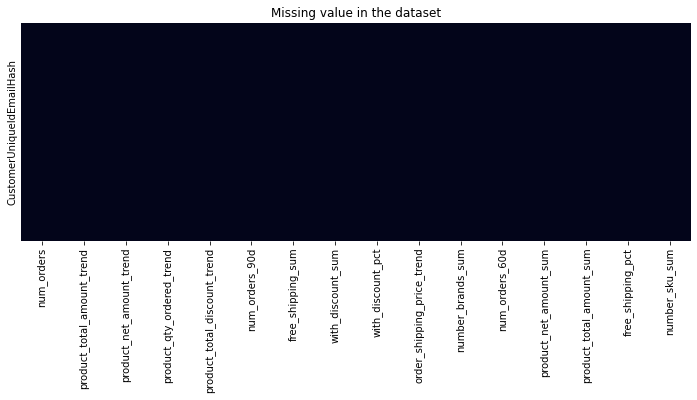

In [10]:
# Looking for null values

plt.figure(figsize=(12,4))
sns.heatmap(df.isnull(),cbar=False,cmap='rocket',yticklabels=False)
plt.title('Missing value in the dataset');

In [11]:
# Check estats

df = df.round(1)
df.describe().T

,count,mean,std,min,25%,50%,75%,max
num_orders,84524.0,1.136103,0.631117,1.0,1.0,1.0,1.0,64.0
product_total_amount_trend,84524.0,1.004999,0.103991,0.0,1.0,1.0,1.0,3.0
product_net_amount_trend,84524.0,1.002927,0.102047,0.0,1.0,1.0,1.0,2.9
product_qty_ordered_trend,84524.0,1.006344,0.102747,0.1,1.0,1.0,1.0,3.2
product_total_discount_trend,84524.0,1.018689,0.241848,0.0,1.0,1.0,1.0,8.0
num_orders_90d,84524.0,0.686894,0.630201,0.0,0.0,1.0,1.0,45.0
free_shipping_sum,84524.0,0.229059,0.671762,0.0,0.0,0.0,0.0,63.0
with_discount_sum,84524.0,0.451813,0.689154,0.0,0.0,0.0,1.0,60.0
with_discount_pct,84524.0,0.388599,0.478077,0.0,0.0,0.0,1.0,1.0
order_shipping_price_trend,84524.0,1.000140,0.162469,0.0,1.0,1.0,1.0,9.6


# DBSCAN clustering
### A density-based cluster is a set of density-connected objects that is maximal regarding density-reachability. Each object not contained in some cluster is considered to be noise.

### DBSCAN checks for clusters by checking the ε-neighborhood of every point in the database. If the ε-neighborhood of a point p contains more than MinPts, a new cluster with p as a core element is produced. DBSCAN iteratively assemble precisely density-reachable objects from these essential element, which can include the merge of a few density-reachable clusters. The process eliminates when no new point can be added to any cluster.

In [12]:
# Setting DBSCAN and common data for both metodologies:

order_df_clusterDB = df[['num_orders','product_total_amount_trend','product_net_amount_trend','product_qty_ordered_trend',\
                  'product_total_discount_trend','num_orders_90d','free_shipping_sum','with_discount_sum',\
                  'with_discount_pct','order_shipping_price_trend','number_brands_sum','num_orders_60d',\
                  'product_net_amount_sum','product_total_amount_sum','free_shipping_pct','number_sku_sum']]

## **(A) Minimum Samples (def_samples)**

There is no automatic way to determine the Minimum Samples value for DBSCAN. Ultimately, the Minimum Samples value should be set using domain knowledge and familiarity with the data set.

### **Rules**:

   - The larger the data set, the larger the value of Minimum Samples should be.
   - If the data set is noisier, choose a larger value of Minimum Samples.
   - Generally, Minimum Samples should be greater than or equal to the dimensionality of the data set
   - For 2-dimensional data, use DBSCAN’s default value of Minimum Samples = 4 (Ester et al., 1996).
   - For more than 2 dim, choose Minimum Samples = 2*dim, where dim= the dimensions of your data set (Sander et al., 1998).

In [13]:
# defining DBSCAN def_samples
# using min dim to max 2*dim = 15 to 30

def_samples = 30

## **(B) ε definition (epsilon or eps)**

We choose two techniques to determine the optimal ε value.

   - Methodology 1: using k-NN. This technique calculates the average distance between each point and its k nearest neighbors, where k = the "Minimum Samples" selected in (A). The average k-distances are then plotted in ascending order on a k-distance graph. The optimal value for ε at the point of maximum curvature (i.e. where the graph has the greatest slope). Source: https://iopscience.iop.org/article/10.1088/1755-1315/31/1/012012/pdf
   
   - Methodology 2: using k-means to support parametrization. Source: https://www.kaggle.com/code/pnarerdoan/k-means-dbscan-clustering/notebook

## **Defining (ε ) - Methodology 1: using k-NN**

In [14]:
# defining DBSCAN epsilon using k-NN

from sklearn.neighbors import NearestNeighbors
from matplotlib import pyplot as plt

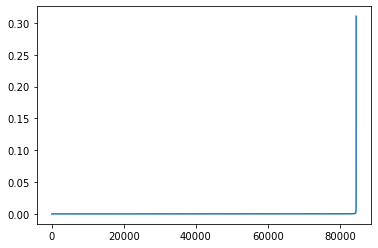

In [15]:
neighbors = NearestNeighbors(n_neighbors=def_samples) # See def_samples definition
neighbors_fit = neighbors.fit(df)
distances, indices = neighbors_fit.kneighbors(df)
distances = np.sort(distances, axis=0)
dist_norm = distances / distances.max()
dist_norm = dist_norm[:,1]

plt.plot(dist_norm)

In [16]:
distances.max()

24952.865490159642

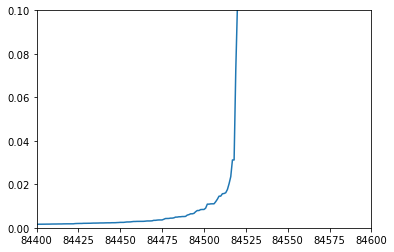

In [17]:
neighbors = NearestNeighbors(n_neighbors=def_samples) # See def_samples definition
neighbors_fit = neighbors.fit(df)
distances, indices = neighbors_fit.kneighbors(df)
distances = np.sort(distances, axis=0)
dist_norm = distances / distances.max()
dist_norm = dist_norm[:,1]

plt.axis([84400, 84600, 0, 0.1])

plt.plot(dist_norm)

### Zooming in on  k-distance plot, it looks like the optimal value for ε is around 0.05, so we will use = 0.1 (round)

In [18]:
order_df_clusterDB = StandardScaler().fit_transform(order_df_clusterDB)
epsilon = 0.1 #see comments above

### Implementing Methodology 1

In [19]:
db = DBSCAN(eps=epsilon, min_samples=def_samples).fit(order_df_clusterDB)
labels = db.labels_
print (labels[500:560])
df["Clus_Db1"]=labels

[ 5 -1  1  5  1  5  3  3  1  3 22  3 39 -1 42 15  3 22  2 36 21 -1 -1 11
  3  1  1 11  1  7  1  3 38 -1  1 -1  1  5 15  3  5 -1  1  3 -1 -1  3 -1
  1  2  5 -1  3  1  8  5 -1 -1 -1  1]


In [20]:
realClusterNum = len(set(labels)) - (1 if -1 in labels else 0)
ClusterNum = len(set(labels))

In [21]:
set(labels)

{-1,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81}

In [22]:
no_clusters = len(np.unique(labels) )
no_noise = np.sum(np.array(labels) == -1, axis=0)

print('Estimated no. of clusters: %d' % no_clusters)
print('Estimated no. of noise points: %d' % no_noise)

Estimated no. of clusters: 83
Estimated no. of noise points: 18346


In [23]:
from sklearn.manifold import TSNE
X_embedded = TSNE(n_components=2).fit_transform(order_df_clusterDB)

C:\Users\ceuli\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

C:\Users\ceuli\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [24]:
df["x_component"]=X_embedded[:,0]
df["y_component"]=X_embedded[:,1]

In [25]:
import plotly.express as px
    
fig = px.scatter(df, x="x_component", y="y_component", hover_name="num_orders", color = "Clus_Db1", size_max=60,
                 labels={
                     "x_component": "X Component",
                     "y_component": "Y Component",
                     "Clus_Db1": "Clusters"
                 },
                title="Methodology 1 - Labels")
fig.update_layout(height=800)
fig.show()

In [26]:
df.groupby('Clus_Db1')['num_orders','product_total_amount_trend','product_net_amount_trend','product_qty_ordered_trend',\
                  'product_total_discount_trend','num_orders_90d','free_shipping_sum','with_discount_sum',\
                  'with_discount_pct','order_shipping_price_trend','number_brands_sum','num_orders_60d',\
                  'product_net_amount_sum','product_total_amount_sum','free_shipping_pct','number_sku_sum'].mean()

C:\Users\ceuli\AppData\Local\Temp\ipykernel_1064\249734093.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,num_orders,product_total_amount_trend,product_net_amount_trend,product_qty_ordered_trend,product_total_discount_trend,num_orders_90d,free_shipping_sum,with_discount_sum,with_discount_pct,order_shipping_price_trend,number_brands_sum,num_orders_60d,product_net_amount_sum,product_total_amount_sum,free_shipping_pct,number_sku_sum
Clus_Db1,,,,,,,,,,,,,,,,
-1,1.623079,1.02303,1.013485,1.029227,1.086106,0.959119,0.819961,0.828955,0.537714,1.000643,3.237927,0.650496,189.646582,216.398065,0.569219,6.093317
0,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,3.000000,1.000000,53.016190,63.328571,0.000000,3.000000
1,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,26.730931,26.730931,0.000000,1.000000
2,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,28.084565,28.084565,0.000000,1.000000
3,1.000000,1.00000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,29.556800,29.556800,0.000000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000,131.848387,147.709677,1.000000,3.000000
78,1.000000,1.00000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,3.000000,0.000000,136.066667,136.066667,1.000000,3.000000
79,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000,105.487879,123.806061,1.000000,3.000000


### Clusters Evaluation -  Silhouette Score

In [27]:
from sklearn import metrics
metrics.silhouette_score(df, df['Clus_Db1'])

-0.3420161303839887

**What is an acceptable silhouette score?**

The value of the silhouette coefﬁcient is between [-1, 1]. A score of 1 denotes the best meaning that the data point i is very compact within the cluster to which it belongs and far away from the other clusters. The worst value is -1. Values near 0 denote overlapping clusters.

Source: https://www.analyticsvidhya.com/blog/2021/05/k-mean-getting-the-optimal-number-of-clusters/

### Clusters Evaluation -  Davies-Bouldin Score

In [28]:
from sklearn import metrics
metrics.davies_bouldin_score(df, df['Clus_Db1'])

3.33488416766699

**What is an acceptable Davies-Bouldin score?**

The score is defined as the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances. Thus, clusters which are farther apart and less dispersed will result in a better score.

The minimum score is zero, with lower values indicating better clustering.

Source: https://scikit-learn.org/stable/modules/generated/sklearn.metrics.davies_bouldin_score.html

## **Defining (ε ) - Methodology 2: using k-Means**

In [29]:
# Apply Principle Component Anaylsis for visualizing the data in 2D space.

pca = PCA()
pca_data = pca.fit_transform(df)
pca_data = pd.DataFrame(pca_data, columns=["pc"+str(i+1) for i in range(len(df.columns))])
print("pca.explained variance ratio:\n ", " ".join(map("{:.3f}".format, pca.explained_variance_ratio_)))

pca.explained variance ratio:
  0.958 0.016 0.015 0.009 0.003 0.000 0.000 0.000 0.000 0.000 0.000 0.000 0.000 0.000 0.000 0.000 0.000 0.000 0.000


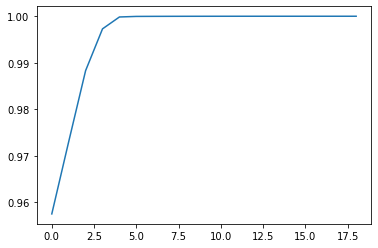

In [30]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))

##### i) PCA was used to visualize the data.
##### ii) From the Explanied Variance Ratio graph, the first two principle component can explain more than 95% of the all variance. Also, there is an elbow after the second principle component, so pc1 and pc2 are enough for representing this data.

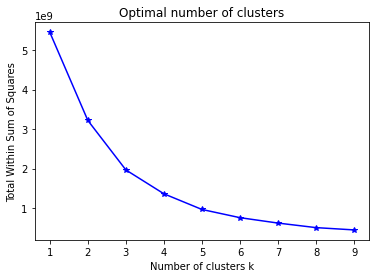

In [31]:
# K-means Clustering
# Plot within-cluster sum of square.

wss = []

K = range(1,10)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=123)
    kmeans = kmeans.fit(df)
    wss.append(kmeans.inertia_)
plt.plot(K, wss, "b*-")
plt.xlabel("Number of clusters k")
plt.ylabel("Total Within Sum of Squares")
plt.title("Optimal number of clusters")
plt.show()

##### iii) Compactness of clustering is measured by total within-cluster sum of square, it should be as small as possible.

##### iv) From the within-cluster sum of square (WSS) graph, it can be said that the optimal number of clusters is 4 because the bend in the knee occurs there.

In [32]:
# Choosing a random number between 0.5 and 4
#import random
#round(random.uniform(0.5, 4),1)

In [33]:
order_df_clusterDB = StandardScaler().fit_transform(order_df_clusterDB)
epsilon = 1.1 # see random above

### Implementing Methodology 2

In [34]:
db = DBSCAN(eps=epsilon, min_samples=def_samples).fit(order_df_clusterDB)
labels = db.labels_
print (labels[500:560])
df["Clus_Db2"]=labels

[ 0 -1  2  0  2  0  5  5  2  5 12  5  0 -1  6  2  5 12  3  5  0  4  7  5
  5  2  2  5  2  7  2  5  2  4  2  7  2  0  2  5  0 11  2  5 11 11  5 10
  2  3  0 -1  5  2  6  0  1 -1 -1  2]


In [35]:
realClusterNum = len(set(labels)) - (1 if -1 in labels else 0)
ClusterNum = len(set(labels))

In [36]:
set(labels)

{-1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19}

In [37]:
no_clusters = len(np.unique(labels) )
no_noise = np.sum(np.array(labels) == -1, axis=0)

print('Estimated no. of clusters: %d' % no_clusters)
print('Estimated no. of noise points: %d' % no_noise)

Estimated no. of clusters: 21
Estimated no. of noise points: 7748


In [38]:
import plotly.express as px
    
fig = px.scatter(df, x="x_component", y="y_component", hover_name="num_orders", color = "Clus_Db2", size_max=60,
                 labels={
                     "x_component": "X Component",
                     "y_component": "Y Component",
                     "Clus_Db2": "Clusters"
                 },
                title="Methodology 2 - Labels")
fig.update_layout(height=800)
fig.show()

In [39]:
df.groupby('Clus_Db2')['num_orders','product_total_amount_trend','product_net_amount_trend','product_qty_ordered_trend',\
                  'product_total_discount_trend','num_orders_90d','free_shipping_sum','with_discount_sum',\
                  'with_discount_pct','order_shipping_price_trend','number_brands_sum','num_orders_60d',\
                  'product_net_amount_sum','product_total_amount_sum','free_shipping_pct','number_sku_sum'].mean()

C:\Users\ceuli\AppData\Local\Temp\ipykernel_1064\1517654103.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,num_orders,product_total_amount_trend,product_net_amount_trend,product_qty_ordered_trend,product_total_discount_trend,num_orders_90d,free_shipping_sum,with_discount_sum,with_discount_pct,order_shipping_price_trend,number_brands_sum,num_orders_60d,product_net_amount_sum,product_total_amount_sum,free_shipping_pct,number_sku_sum
Clus_Db2,,,,,,,,,,,,,,,,
-1,2.411332,1.053136,1.031415,1.067734,1.197367,1.373774,0.979866,1.141714,0.462171,1.001278,4.247677,0.950181,255.392308,293.046477,0.386151,7.623387
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.216275,1.000000,31.639817,41.779533,0.000000,1.570133
1,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.629829,0.000000,159.167350,159.167350,1.000000,3.358415
2,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.063580,1.000000,32.047168,32.047168,0.000000,1.295818
3,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.073013,0.000000,34.172128,34.172128,0.000000,1.324531
4,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.685125,1.000000,143.721571,180.365726,1.000000,5.361925
5,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.090233,0.000000,35.746154,35.746154,0.000000,1.368812
6,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.217153,0.000000,37.470712,49.585356,0.000000,1.677955
7,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,1.575088,1.000000,161.632044,161.632044,1.000000,3.371673


### Clusters Evaluation -  Silhouette Score

In [40]:
from sklearn import metrics
metrics.silhouette_score(df, df['Clus_Db2'])

-0.16471283218867058

**What is an acceptable silhouette score?**

The value of the silhouette coefﬁcient is between [-1, 1]. A score of 1 denotes the best meaning that the data point i is very compact within the cluster to which it belongs and far away from the other clusters. The worst value is -1. Values near 0 denote overlapping clusters.

Source: https://www.analyticsvidhya.com/blog/2021/05/k-mean-getting-the-optimal-number-of-clusters/

### Clusters Evaluation -  Davies-Bouldin Score

In [41]:
from sklearn import metrics
metrics.davies_bouldin_score(df, df['Clus_Db2'])

8.207803131223502

**What is an acceptable Davies-Bouldin score?**

The score is defined as the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances. Thus, clusters which are farther apart and less dispersed will result in a better score.

The minimum score is zero, with lower values indicating better clustering.

Source: https://scikit-learn.org/stable/modules/generated/sklearn.metrics.davies_bouldin_score.html

**Conslusion:**

We have identified three possible reasons to DBSCAN to fail:


- It fails due varying density clusters;
- It fails because it not work well in case of high dimensional data;
- Despite our efforts, the episilon and/or the min_samples were not well defined.

Source: Density-based clustering algorithms – DBSCAN and SNN by Adriano Moreira, Maribel Y. Santos and Sofia Carneiro.

**Due the results(Silhouette Score) we've obtained, DBSCAN clustering will not be used as a clustering tool for our work. We will implement RFM or Hierarchical Clustering instead.**